In [128]:
# in this version, the tresholding is automated.

%matplotlib inline

import cv2
import numpy as np
from matplotlib import pyplot as plt

import pandas as pd
import pims
from PIL import Image


# in this version, the tresholding is automated.

%matplotlib inline

import cv2
import numpy as np
from matplotlib import pyplot as plt

import pandas as pd
import pims
from PIL import Image


import csv


#http://soft-matter.github.io/trackpy/v0.3.2/tutorial/walkthrough.html


from __future__ import division, unicode_literals, print_function  # for compatibility with Python 2 and 3

import matplotlib as mpl
import matplotlib.pyplot as plt

# change the following to %matplotlib notebook for interactive plotting
%matplotlib inline

# Optionally, tweak styles.
#mpl.rc('figure',  figsize=(10, 6))
#mpl.rc('image', cmap='gray')

import numpy as np
import pandas as pd
from pandas import DataFrame, Series  # for convenience

import pims

import scipy


import math



import scipy.ndimage

#own modules / functions
import sys
pythonPackagePath = "/Users/johannesschoeneberg/git/JohSchoeneberg/Confleezers/confleezers_data_analysis/"
sys.path.append(pythonPackagePath+"/modules")
import InputProcessing as inproc
import ForceFileProcessing as ffp
import TubeProcessing as tubeProc


#### plot definitions
#https://stackoverflow.com/questions/22408237/named-colors-in-matplotlib
#c_ch1 = 'aqua'
#c_ch1 = 'deepskyblue'
#c_ch1 = 'cyan'

#c_ch2 = 'springgreen'
#c_ch2 = 'lime'
#c_ch3 = 'red'
#lwidth = 3

#xlimit = (-150,300)

In [17]:
def drawX(centerPx,length,A,size):
    resultImage = np.zeros((size[0], size[1]))
    centerPx = np.array(centerPx).astype(int)
    for x in range(centerPx[0]-int(length/2),centerPx[0]+int(length/2)+1):
        #print(x)
        resultImage[centerPx[1]-2,x] = A
        resultImage[centerPx[1]-1,x] = A
        resultImage[centerPx[1],x] = A
        resultImage[centerPx[1]+1,x] = A
        resultImage[centerPx[1]+2,x] = A
    for y in range(centerPx[1]-int(length/2),centerPx[1]+int(length/2)+1):
        resultImage[y,centerPx[0]-2] = A
        resultImage[y,centerPx[0]-1] = A
        resultImage[y,centerPx[0]] = A
        resultImage[y,centerPx[0]+1] = A
        resultImage[y,centerPx[0]+2] = A
    return resultImage

In [18]:
def getXandYArrayGivenCenter(centerPx,img,averagingMargin):
    xArray = np.average(img[:,centerPx[0]-averagingMargin:centerPx[0]+averagingMargin],axis=1)
    yArray = np.average(img[centerPx[1]-averagingMargin:centerPx[1]+averagingMargin,:],axis=0)
    return[xArray,yArray]

In [129]:

folder = '/Volumes/Samsung_T3b/science/confleezers/2018-06-12/v3/'

filename = 'guv_centers.csv'
dfcenters = pd.read_csv(''.join([folder,'/',filename]))
xCenter = dfcenters['x'].astype(float).values[0]
yCenter = dfcenters['y'].astype(float).values[0]
center0 = np.array([xCenter+correction[0],yCenter+correction[0]])
print(center0)

ltopxConversion =1
center0px = (center0*ltopxConversion).astype(int)
print("center of cross: {}".format(center0px))
movie_filename = folder+"/movie_ch0_avg20_bleachCorrected.tif"
print(movie_filename)



all_movie_frames = pims.TiffStack_pil(movie_filename)

ch0 = all_movie_frames



[  76.  172.]
center of cross: [ 76 172]
/Volumes/Samsung_T3b/science/confleezers/2018-06-12/v3//movie_ch0_avg20_bleachCorrected.tif


In [130]:
dfcenters

,id,x,y,comment
0,0,76,172,NaN


246 149


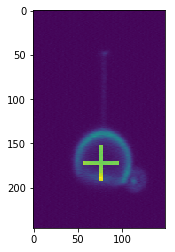

In [131]:
# show the center proposal ontop of the raw data
image = ch1[10]
print(len(image),len(image[0]))
plt.show()
crossImage = drawX(center0px,40,2000,[len(image),len(image[0])])
summedImage = image + crossImage
plt.imshow(summedImage)


In [132]:
def calculateThreshold(center,image,margin=30):
    insideGUV = np.average(image[center[1]-margin:center[1]+margin,center[0]-margin:center[0]+margin])
    xArray = np.average(image[:,0:30],axis=1)# get the first n lines of the img in x
    yArray = np.average(image[0:30,:],axis=0)# get the first n lines of the img in y
    background=(np.average(xArray)+np.average(yArray))/2
    treshold = insideGUV+(background-insideGUV)/2
    if(insideGUV>background):
        treshold = 1.2*insideGUV
    return [treshold,insideGUV,background]

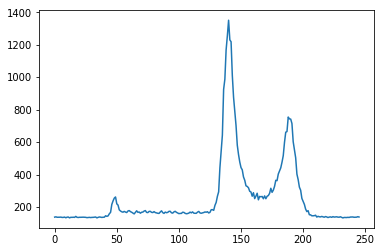

amplitudes treshold: 607.6113333333333, insideGUV: 506.34277777777777, outside background: 136.58484612866263


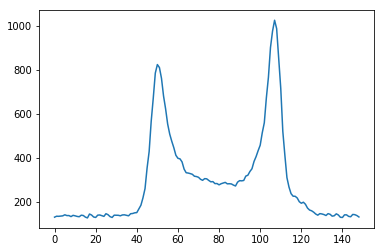

In [133]:
xArray, yArray = getXandYArrayGivenCenter(center0px,image,10)
plt.plot(xArray)
plt.show()
plt.plot(yArray)
tresholdCalc = calculateThreshold(center0px,image)
print("amplitudes treshold: {}, insideGUV: {}, outside background: {}".format(tresholdCalc[0],tresholdCalc[1],tresholdCalc[2]))

In [134]:
def plot3ChannelImage(frames,filename):
    fig = plt.figure(dpi=150)
    ax = fig.subplots(nrows=1, ncols=3)
    
    plt.subplot(1, 3, 1)
    plt.imshow(frames[0])
    plt.subplot(1, 3, 2)
    plt.imshow(frames[1])
    plt.subplot(1, 3, 3)
    plt.imshow(frames[2])
    #plt.title(filename)
    plt.tight_layout()

#    plt.imsave('figc.png',figc,cmap=None)
    plt.savefig(str('./'+filename+'.png'))#,figc,cmap=None)

In [135]:
#get the amplitude in the center

#get the background amplitude

#define the threshold
def computeBoundariesMiddleOut(center,image,tresholds,avgSize=10,verbose=False):
    
        

    #print(verbose)
    xArray, yArray = getXandYArrayGivenCenter(center,image,avgSize)
#pick the points immediately left and right to the center that go through the treshold
#split into two arrays a = xArray[0:centerPx[0]], b = xArray[centerPx[0]:-1]
    x_threshold = tresholds[0]
    left_x_SearchArray = xArray[0:center[1]]
    try:    
        x_idxLeft = np.nonzero(left_x_SearchArray>x_threshold)[0][-1]
    except IndexError:
        x_idxLeft = 0     


    right_x_SearchArray = xArray[center[1]:-1]
    try:
        x_idxRight = center[1]+np.nonzero(right_x_SearchArray>x_threshold)[0][0]
    except IndexError:
        x_idxRight = 511 

    if(verbose):
        #plt.plot(left_x_SearchArray)
        #plt.show()
        #plt.plot(right_x_SearchArray)
        #plt.show()
        print("x_threshold {}".format(x_threshold))
        print("computeBoundariesMiddleOut: x left {} right {}".format(x_idxLeft,x_idxRight))
        
        
        #plt.gray()
        fig, axes = plt.subplots(ncols=2, figsize=(8, 2))
        ax = axes.ravel()
        ax[0].plot(xArray)
        ax[0].set_title('yArray')
        ax[0].axvline(x=x_idxLeft,c='r')
        ax[0].axvline(x=x_idxRight,c='r')


###------


    y_threshold =  tresholds[1]
    left_y_SearchArray = yArray[0:center[0]]
    try:
        y_idxLeft = np.nonzero(left_y_SearchArray>y_threshold)[0][-1]
    except IndexError:
        y_idxLeft = 0
    
    right_y_SearchArray = yArray[center[0]:-1]
    try:
        y_idxRight = center[0]+np.nonzero(right_y_SearchArray>y_threshold)[0][0]
    except IndexError:
        y_idxRight = 511    
    #print("x left {} right {}".format(y_idxLeft,y_idxRight))
    
    if(verbose):
        ax[1].plot(yArray)
        ax[1].set_title('xArray')
        ax[1].axvline(x=y_idxLeft,c='r')
        ax[1].axvline(x=y_idxRight,c='r')
        plt.savefig('./vesicle_circleFit/circleFit_frame_'+str(frameId)+'_xy.png')
        #plt.show()
        
    
    return [x_idxLeft,x_idxRight,y_idxLeft,y_idxRight]

In [136]:
def computeNewCircle(center,image,tresholds,verbose=False):
    x_idxLeft,x_idxRight,y_idxLeft,y_idxRight = computeBoundariesMiddleOut(center0px,img,tresholds,verbose=verbose)
    xdist = x_idxRight-x_idxLeft
    ydist = y_idxRight-y_idxLeft
    centerX = x_idxLeft+int((xdist)/2)
    centerY = y_idxLeft+int((ydist)/2)
    #radius = np.mean(np.array([xdist,ydist]))/2
    radius = 1.1*np.max(np.array([xdist,ydist]))/2
    return(centerX,centerY,radius)

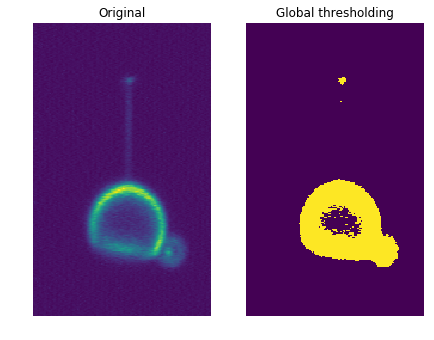

In [137]:
from skimage.filters import threshold_otsu, threshold_local
#from skimage.filters import threshold_minimum
from skimage.filters import threshold_yen
from skimage.filters import threshold_li
from skimage.filters import threshold_triangle


image = ch0[30]

global_thresh = threshold_otsu(image)
global_thresh = threshold_li(image)
binary_global = image > global_thresh



fig, axes = plt.subplots(ncols=2, figsize=(7, 8))
ax = axes.ravel()
#plt.gray()

ax[0].imshow(image)
ax[0].set_title('Original')

ax[1].imshow(binary_global)
ax[1].set_title('Global thresholding')


for a in ax:
    a.axis('off')

plt.show()

[  0 255]
[[0 0 0 ..., 0 0 0]
 [0 0 0 ..., 0 0 0]
 [0 0 0 ..., 0 0 0]
 ..., 
 [0 0 0 ..., 0 0 0]
 [0 0 0 ..., 0 0 0]
 [0 0 0 ..., 0 0 0]]

[ 76 172]
treshold: 607.6006666666667, insideGUV: 506.3338888888889, outside background: 136.6964101234972, 
x_threshold 607.6006666666667
computeBoundariesMiddleOut: x left 146 right 186
centerx 166 centery 78
[[[78, 166, 26.950000000000003]]]


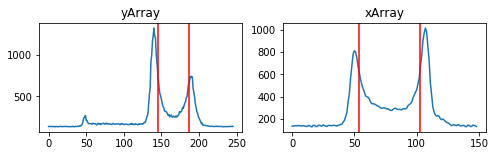

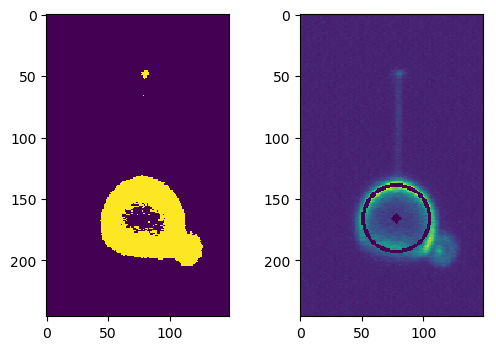

In [138]:
#frames = allImages[5]


img2 = binary_global.astype('uint8')*255
#img2 = img_fijiThreshold
print(np.unique(img2))
print(img2)
print()
#binary_global.astype('uint8')
#plt.imshow(img2)
#img8 = (img2/256).astype('uint8')
img8 = img2

img = cv2.medianBlur(img8,3)
#plt.imshow(img)
#cimg = cv2.cvtColor(img,cv2.COLOR_GRAY2BGR)
cimg = image


img = ch0[26]
print(center0px)
tresholdCalc = calculateThreshold(center0px,img)
thresholds_xy= [tresholdCalc[0],tresholdCalc[0]]
print("treshold: {}, insideGUV: {}, outside background: {}, ".format(tresholdCalc[0],tresholdCalc[1],tresholdCalc[2]))
centerx, centery, radius = computeNewCircle(center0px,img,thresholds_xy,verbose=True)
print("centerx {} centery {}".format(centerx,centery))
circles = [[[centery,centerx,radius]]]

print(circles)
#circles is literally:
#    [xCoord,yCoord,Radius]
# [[[ 279.75        276.75        105.45200348]]]

circles = np.uint16(np.around(circles))
for i in circles[0,:]:
    # draw the outer circle
    cv2.circle(cimg,(i[0],i[1]),i[2],(0,255,0),2)
    # draw the center of the circle
    cv2.circle(cimg,(i[0],i[1]),2,(0,0,255),3)

#cv2.imshow('detected circles',cimg)
#cv2.waitKey(0)
#cv2.destroyAllWindows()

fig = plt.figure(dpi=100)
ax = fig.subplots(nrows=1, ncols=2)
    
plt.subplot(1, 2, 1)
plt.imshow(img2)
plt.subplot(1, 2, 2)
plt.imshow(cimg)

#plt.show()

0
treshold: 608.2363333333333, insideGUV: 506.8636111111111, outside background: 136.53251123115257, 
x_threshold 608.2363333333333
computeBoundariesMiddleOut: x left 147 right 186
treshold: 608.6966666666666, insideGUV: 507.2472222222222, outside background: 136.57018560957422, 
x_threshold 608.6966666666666
computeBoundariesMiddleOut: x left 147 right 186
treshold: 608.3046666666667, insideGUV: 506.92055555555555, outside background: 136.56832405740167, 
x_threshold 608.3046666666667
computeBoundariesMiddleOut: x left 147 right 186
treshold: 608.3373333333333, insideGUV: 506.9477777777778, outside background: 136.56320910860114, 
x_threshold 608.3373333333333
computeBoundariesMiddleOut: x left 147 right 186
treshold: 608.5736666666667, insideGUV: 507.14472222222224, outside background: 136.57613084520102, 
x_threshold 608.5736666666667
computeBoundariesMiddleOut: x left 147 right 186
treshold: 608.4483333333333, insideGUV: 507.04027777777776, outside background: 136.5362316072825, 
x

/Users/johannesschoeneberg/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:523: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


treshold: 607.6113333333333, insideGUV: 506.34277777777777, outside background: 136.58484612866263, 
x_threshold 607.6113333333333
computeBoundariesMiddleOut: x left 146 right 186
treshold: 608.0673333333333, insideGUV: 506.72277777777776, outside background: 136.6020866299267, 
x_threshold 608.0673333333333
computeBoundariesMiddleOut: x left 146 right 186
treshold: 607.8513333333333, insideGUV: 506.54277777777776, outside background: 136.5921772976119, 
x_threshold 607.8513333333333
computeBoundariesMiddleOut: x left 146 right 186
treshold: 607.0396666666667, insideGUV: 505.8663888888889, outside background: 136.6275681599098, 
x_threshold 607.0396666666667
computeBoundariesMiddleOut: x left 146 right 186
treshold: 606.9019999999999, insideGUV: 505.75166666666667, outside background: 136.68671950310107, 
x_threshold 606.9019999999999
computeBoundariesMiddleOut: x left 146 right 186
treshold: 607.6006666666667, insideGUV: 506.3338888888889, outside background: 136.6964101234972, 
x_thr

treshold: 604.626, insideGUV: 503.855, outside background: 136.60797866535714, 
x_threshold 604.626
computeBoundariesMiddleOut: x left 147 right 186
70
treshold: 604.444, insideGUV: 503.7033333333333, outside background: 136.59793746930757, 
x_threshold 604.444
computeBoundariesMiddleOut: x left 147 right 186
treshold: 604.814, insideGUV: 504.01166666666666, outside background: 136.59962987213765, 
x_threshold 604.814
computeBoundariesMiddleOut: x left 147 right 186
treshold: 604.9499999999999, insideGUV: 504.125, outside background: 136.62781961041088, 
x_threshold 604.9499999999999
computeBoundariesMiddleOut: x left 147 right 186
treshold: 605.4716666666666, insideGUV: 504.5597222222222, outside background: 136.6129826667394, 
x_threshold 605.4716666666666
computeBoundariesMiddleOut: x left 147 right 186
treshold: 605.423, insideGUV: 504.51916666666665, outside background: 136.65311971408306, 
x_threshold 605.423
computeBoundariesMiddleOut: x left 147 right 186
treshold: 605.32833333

treshold: 602.935, insideGUV: 502.4458333333333, outside background: 136.85947008966735, 
x_threshold 602.935
computeBoundariesMiddleOut: x left 149 right 187
treshold: 603.1906666666666, insideGUV: 502.6588888888889, outside background: 136.85618895618484, 
x_threshold 603.1906666666666
computeBoundariesMiddleOut: x left 149 right 187
120
treshold: 602.9566666666667, insideGUV: 502.4638888888889, outside background: 136.82590576744695, 
x_threshold 602.9566666666667
computeBoundariesMiddleOut: x left 149 right 187
treshold: 602.732, insideGUV: 502.27666666666664, outside background: 136.84817891635294, 
x_threshold 602.732
computeBoundariesMiddleOut: x left 149 right 187
treshold: 602.2553333333333, insideGUV: 501.87944444444446, outside background: 136.86098288499664, 
x_threshold 602.2553333333333
computeBoundariesMiddleOut: x left 149 right 187
treshold: 601.7439999999999, insideGUV: 501.4533333333333, outside background: 136.82110729160985, 
x_threshold 601.7439999999999
computeBo

treshold: 601.1266666666667, insideGUV: 500.93888888888887, outside background: 137.045730797912, 
x_threshold 601.1266666666667
computeBoundariesMiddleOut: x left 149 right 187
treshold: 601.0783333333333, insideGUV: 500.8986111111111, outside background: 137.0634710172605, 
x_threshold 601.0783333333333
computeBoundariesMiddleOut: x left 149 right 187
treshold: 600.592, insideGUV: 500.49333333333334, outside background: 137.0802390825922, 
x_threshold 600.592
computeBoundariesMiddleOut: x left 149 right 187
treshold: 600.4813333333333, insideGUV: 500.4011111111111, outside background: 137.0914602317164, 
x_threshold 600.4813333333333
computeBoundariesMiddleOut: x left 149 right 187
170
treshold: 600.2106666666666, insideGUV: 500.17555555555555, outside background: 137.11880013095436, 
x_threshold 600.2106666666666
computeBoundariesMiddleOut: x left 149 right 187
treshold: 599.5703333333333, insideGUV: 499.64194444444445, outside background: 137.1506602280788, 
x_threshold 599.5703333

treshold: 592.8743333333333, insideGUV: 494.06194444444446, outside background: 137.16963360069843, 
x_threshold 592.8743333333333
computeBoundariesMiddleOut: x left 149 right 189
treshold: 593.0176666666666, insideGUV: 494.1813888888889, outside background: 137.17610492715664, 
x_threshold 593.0176666666666
computeBoundariesMiddleOut: x left 149 right 189
treshold: 591.929, insideGUV: 493.27416666666664, outside background: 137.14154617049525, 
x_threshold 591.929
computeBoundariesMiddleOut: x left 149 right 189
treshold: 591.2686666666666, insideGUV: 492.7238888888889, outside background: 137.11133437005512, 
x_threshold 591.2686666666666
computeBoundariesMiddleOut: x left 149 right 188
treshold: 590.2353333333333, insideGUV: 491.86277777777775, outside background: 137.10537276513702, 
x_threshold 590.2353333333333
computeBoundariesMiddleOut: x left 150 right 188
treshold: 590.6176666666667, insideGUV: 492.1813888888889, outside background: 137.1174319310307, 
x_threshold 590.6176666

computeBoundariesMiddleOut: x left 151 right 189
treshold: 584.6936666666667, insideGUV: 487.2447222222222, outside background: 137.34847356359472, 
x_threshold 584.6936666666667
computeBoundariesMiddleOut: x left 151 right 189
treshold: 584.909, insideGUV: 487.4241666666667, outside background: 137.3859069496735, 
x_threshold 584.909
computeBoundariesMiddleOut: x left 151 right 189
treshold: 585.3543333333333, insideGUV: 487.79527777777776, outside background: 137.45900674778557, 
x_threshold 585.3543333333333
computeBoundariesMiddleOut: x left 151 right 190
treshold: 585.827, insideGUV: 488.18916666666667, outside background: 137.47590167512413, 
x_threshold 585.827
computeBoundariesMiddleOut: x left 151 right 189
treshold: 584.7959999999999, insideGUV: 487.33, outside background: 137.51087330168605, 
x_threshold 584.7959999999999
computeBoundariesMiddleOut: x left 151 right 511
treshold: 584.5953333333333, insideGUV: 487.16277777777776, outside background: 137.5456689583674, 
x_thre

treshold: 574.6496666666666, insideGUV: 478.8747222222222, outside background: 138.55483803495753, 
x_threshold 574.6496666666666
computeBoundariesMiddleOut: x left 152 right 511
treshold: 574.38, insideGUV: 478.65, outside background: 138.5930016733053, 
x_threshold 574.38
computeBoundariesMiddleOut: x left 152 right 511
treshold: 573.7183333333332, insideGUV: 478.0986111111111, outside background: 138.64010385405868, 
x_threshold 573.7183333333332
computeBoundariesMiddleOut: x left 152 right 511
treshold: 573.3513333333333, insideGUV: 477.79277777777776, outside background: 138.6821220057838, 
x_threshold 573.3513333333333
computeBoundariesMiddleOut: x left 152 right 511
treshold: 573.165, insideGUV: 477.6375, outside background: 138.6415384405522, 
x_threshold 573.165
computeBoundariesMiddleOut: x left 152 right 511
treshold: 573.251, insideGUV: 477.70916666666665, outside background: 138.68250259180445, 
x_threshold 573.251
computeBoundariesMiddleOut: x left 152 right 511
treshold:

computeBoundariesMiddleOut: x left 151 right 511
treshold: 583.4733333333332, insideGUV: 486.22777777777776, outside background: 138.422712846256, 
x_threshold 583.4733333333332
computeBoundariesMiddleOut: x left 151 right 511
treshold: 585.113, insideGUV: 487.5941666666667, outside background: 138.40235444971898, 
x_threshold 585.113
computeBoundariesMiddleOut: x left 151 right 192
360
treshold: 586.3463333333333, insideGUV: 488.62194444444447, outside background: 138.2883273312599, 
x_threshold 586.3463333333333
computeBoundariesMiddleOut: x left 150 right 191
treshold: 588.1683333333333, insideGUV: 490.1402777777778, outside background: 138.31217829795747, 
x_threshold 588.1683333333333
computeBoundariesMiddleOut: x left 150 right 191
treshold: 590.3626666666667, insideGUV: 491.9688888888889, outside background: 138.28918990196615, 
x_threshold 590.3626666666667
computeBoundariesMiddleOut: x left 150 right 191
treshold: 591.9986666666666, insideGUV: 493.33222222222224, outside backg

x_threshold 599.5383333333333
computeBoundariesMiddleOut: x left 150 right 189
treshold: 599.0383333333333, insideGUV: 499.1986111111111, outside background: 138.12531738236845, 
x_threshold 599.0383333333333
computeBoundariesMiddleOut: x left 150 right 189
treshold: 598.9166666666666, insideGUV: 499.09722222222223, outside background: 138.18539995634853, 
x_threshold 598.9166666666666
computeBoundariesMiddleOut: x left 150 right 189
treshold: 598.7266666666666, insideGUV: 498.93888888888887, outside background: 138.2053545770357, 
x_threshold 598.7266666666666
computeBoundariesMiddleOut: x left 150 right 189
treshold: 598.7456666666667, insideGUV: 498.95472222222224, outside background: 138.22429748458558, 
x_threshold 598.7456666666667
computeBoundariesMiddleOut: x left 150 right 189
410
treshold: 598.7053333333333, insideGUV: 498.9211111111111, outside background: 138.22474809479638, 
x_threshold 598.7053333333333
computeBoundariesMiddleOut: x left 150 right 190
treshold: 598.952666

x_threshold 591.044
computeBoundariesMiddleOut: x left 150 right 190
treshold: 590.6496666666667, insideGUV: 492.2080555555556, outside background: 138.1773112529783, 
x_threshold 590.6496666666667
computeBoundariesMiddleOut: x left 150 right 190
treshold: 590.3093333333333, insideGUV: 491.9244444444444, outside background: 138.2334870227897, 
x_threshold 590.3093333333333
computeBoundariesMiddleOut: x left 150 right 190
treshold: 590.293, insideGUV: 491.91083333333336, outside background: 138.28248394900058, 
x_threshold 590.293
computeBoundariesMiddleOut: x left 150 right 190
treshold: 590.148, insideGUV: 491.79, outside background: 138.2947240865026, 
x_threshold 590.148
computeBoundariesMiddleOut: x left 150 right 190
treshold: 589.9546666666666, insideGUV: 491.62888888888887, outside background: 138.3524126516433, 
x_threshold 589.9546666666666
computeBoundariesMiddleOut: x left 150 right 190
460
treshold: 590.987, insideGUV: 492.4891666666667, outside background: 138.376144940979

x_threshold 597.9263333333333
computeBoundariesMiddleOut: x left 150 right 190
treshold: 598.1446666666667, insideGUV: 498.4538888888889, outside background: 138.13375029555664, 
x_threshold 598.1446666666667
computeBoundariesMiddleOut: x left 150 right 189
treshold: 598.63, insideGUV: 498.85833333333335, outside background: 138.15951874283843, 
x_threshold 598.63
computeBoundariesMiddleOut: x left 150 right 189
treshold: 598.582, insideGUV: 498.8183333333333, outside background: 138.20128226114474, 
x_threshold 598.582
computeBoundariesMiddleOut: x left 150 right 189
treshold: 598.7266666666666, insideGUV: 498.93888888888887, outside background: 138.1755952056165, 
x_threshold 598.7266666666666
computeBoundariesMiddleOut: x left 150 right 189
treshold: 599.364, insideGUV: 499.47, outside background: 138.16818491842636, 
x_threshold 599.364
computeBoundariesMiddleOut: x left 150 right 189
treshold: 599.3969999999999, insideGUV: 499.4975, outside background: 138.1600571106382, 
x_thresh

x_threshold 590.784
computeBoundariesMiddleOut: x left 150 right 191
treshold: 589.8803333333333, insideGUV: 491.56694444444446, outside background: 138.35096305996615, 
x_threshold 589.8803333333333
computeBoundariesMiddleOut: x left 150 right 191
treshold: 589.3926666666666, insideGUV: 491.16055555555556, outside background: 138.29676933849873, 
x_threshold 589.3926666666666
computeBoundariesMiddleOut: x left 150 right 191
treshold: 588.672, insideGUV: 490.56, outside background: 138.25623215292558, 
x_threshold 588.672
computeBoundariesMiddleOut: x left 150 right 191
treshold: 589.2696666666666, insideGUV: 491.05805555555554, outside background: 138.23595969516742, 
x_threshold 589.2696666666666
computeBoundariesMiddleOut: x left 150 right 191
treshold: 589.15, insideGUV: 490.9583333333333, outside background: 138.26138938906166, 
x_threshold 589.15
computeBoundariesMiddleOut: x left 150 right 191
treshold: 588.7786666666667, insideGUV: 490.6488888888889, outside background: 138.239

treshold: 581.4503333333333, insideGUV: 484.5419444444444, outside background: 138.068247667376, 
x_threshold 581.4503333333333
computeBoundariesMiddleOut: x left 151 right 511
treshold: 582.0956666666667, insideGUV: 485.07972222222224, outside background: 138.06904157799966, 
x_threshold 582.0956666666667
computeBoundariesMiddleOut: x left 151 right 511
treshold: 582.0053333333333, insideGUV: 485.00444444444446, outside background: 138.07769775013185, 
x_threshold 582.0053333333333
computeBoundariesMiddleOut: x left 151 right 511
treshold: 582.0029999999999, insideGUV: 485.0025, outside background: 138.0279869409432, 
x_threshold 582.0029999999999
computeBoundariesMiddleOut: x left 151 right 511
treshold: 581.8783333333333, insideGUV: 484.8986111111111, outside background: 137.99502373547227, 
x_threshold 581.8783333333333
computeBoundariesMiddleOut: x left 151 right 511
treshold: 581.6693333333333, insideGUV: 484.72444444444443, outside background: 137.94794610865574, 
x_threshold 58

x_threshold 574.0283333333333
computeBoundariesMiddleOut: x left 152 right 511
treshold: 574.0236666666666, insideGUV: 478.35305555555556, outside background: 138.36719321220056, 
x_threshold 574.0236666666666
computeBoundariesMiddleOut: x left 152 right 511
treshold: 574.2326666666667, insideGUV: 478.52722222222224, outside background: 138.40373265309836, 
x_threshold 574.2326666666667
computeBoundariesMiddleOut: x left 152 right 511
treshold: 573.5676666666667, insideGUV: 477.97305555555556, outside background: 138.42106500427423, 
x_threshold 573.5676666666667
computeBoundariesMiddleOut: x left 152 right 511
treshold: 573.3646666666666, insideGUV: 477.8038888888889, outside background: 138.44673932813154, 
x_threshold 573.3646666666666
computeBoundariesMiddleOut: x left 152 right 511
treshold: 573.283, insideGUV: 477.73583333333335, outside background: 138.4881909204998, 
x_threshold 573.283
computeBoundariesMiddleOut: x left 152 right 511
treshold: 573.207, insideGUV: 477.6725, out

x_threshold 581.84
computeBoundariesMiddleOut: x left 151 right 192
treshold: 585.3166666666667, insideGUV: 487.7638888888889, outside background: 138.48175278732657, 
x_threshold 585.3166666666667
computeBoundariesMiddleOut: x left 150 right 192
treshold: 588.8113333333333, insideGUV: 490.6761111111111, outside background: 138.4682772230407, 
x_threshold 588.8113333333333
computeBoundariesMiddleOut: x left 150 right 192
treshold: 591.1659999999999, insideGUV: 492.6383333333333, outside background: 138.45678370709882, 
x_threshold 591.1659999999999
computeBoundariesMiddleOut: x left 150 right 192
treshold: 593.3226666666666, insideGUV: 494.43555555555554, outside background: 138.394681799167, 
x_threshold 593.3226666666666
computeBoundariesMiddleOut: x left 150 right 192
treshold: 596.5893333333333, insideGUV: 497.15777777777777, outside background: 138.37079582037433, 
x_threshold 596.5893333333333
computeBoundariesMiddleOut: x left 149 right 191
treshold: 599.6696666666667, insideGUV

750
treshold: 625.4206666666666, insideGUV: 521.1838888888889, outside background: 138.76833724377514, 
x_threshold 625.4206666666666
computeBoundariesMiddleOut: x left 148 right 192
treshold: 625.4219999999999, insideGUV: 521.185, outside background: 138.78907486222514, 
x_threshold 625.4219999999999
computeBoundariesMiddleOut: x left 148 right 192
treshold: 625.3283333333334, insideGUV: 521.1069444444445, outside background: 138.79566895836743, 
x_threshold 625.3283333333334
computeBoundariesMiddleOut: x left 148 right 192
treshold: 624.9376666666666, insideGUV: 520.7813888888888, outside background: 138.80716884014478, 
x_threshold 624.9376666666666
computeBoundariesMiddleOut: x left 148 right 192
treshold: 626.0869999999999, insideGUV: 521.7391666666666, outside background: 138.8349352503592, 
x_threshold 626.0869999999999
computeBoundariesMiddleOut: x left 148 right 192
treshold: 625.7336666666666, insideGUV: 521.4447222222223, outside background: 138.8700637492952, 
x_threshold 6

800
treshold: 619.6916666666666, insideGUV: 516.4097222222222, outside background: 139.2476550990342, 
x_threshold 619.6916666666666
computeBoundariesMiddleOut: x left 149 right 192
treshold: 620.2673333333332, insideGUV: 516.8894444444444, outside background: 139.2542864807843, 
x_threshold 620.2673333333332
computeBoundariesMiddleOut: x left 149 right 192
treshold: 619.8593333333333, insideGUV: 516.5494444444445, outside background: 139.27447572797877, 
x_threshold 619.8593333333333
computeBoundariesMiddleOut: x left 149 right 192
treshold: 619.4496666666666, insideGUV: 516.2080555555556, outside background: 139.33945908586605, 
x_threshold 619.4496666666666
computeBoundariesMiddleOut: x left 149 right 192
treshold: 620.1800000000001, insideGUV: 516.8166666666667, outside background: 139.32330441425222, 
x_threshold 620.1800000000001
computeBoundariesMiddleOut: x left 149 right 192
treshold: 620.6016666666667, insideGUV: 517.1680555555556, outside background: 139.31762563431005, 
x_t

treshold: 610.9466666666666, insideGUV: 509.1222222222222, outside background: 139.4707439842855, 
x_threshold 610.9466666666666
computeBoundariesMiddleOut: x left 149 right 192
treshold: 611.0073333333332, insideGUV: 509.17277777777775, outside background: 139.52801831541802, 
x_threshold 611.0073333333332
computeBoundariesMiddleOut: x left 149 right 192
850
treshold: 611.4516666666666, insideGUV: 509.54305555555555, outside background: 139.57133373347156, 
x_threshold 611.4516666666666
computeBoundariesMiddleOut: x left 149 right 192
treshold: 611.596, insideGUV: 509.66333333333336, outside background: 139.51934986631747, 
x_threshold 611.596
computeBoundariesMiddleOut: x left 149 right 192
treshold: 611.3969999999999, insideGUV: 509.4975, outside background: 139.542421927575, 
x_threshold 611.3969999999999
computeBoundariesMiddleOut: x left 149 right 192
treshold: 611.9396666666667, insideGUV: 509.94972222222225, outside background: 139.51570724432077, 
x_threshold 611.9396666666667

treshold: 604.7626666666666, insideGUV: 503.9688888888889, outside background: 139.33596697040798, 
x_threshold 604.7626666666666
computeBoundariesMiddleOut: x left 149 right 192
treshold: 604.5886666666667, insideGUV: 503.8238888888889, outside background: 139.34360460886487, 
x_threshold 604.5886666666667
computeBoundariesMiddleOut: x left 149 right 192
treshold: 604.289, insideGUV: 503.57416666666666, outside background: 139.3460395409323, 
x_threshold 604.289
computeBoundariesMiddleOut: x left 149 right 192
900
treshold: 604.154, insideGUV: 503.46166666666664, outside background: 139.34962350630218, 
x_threshold 604.154
computeBoundariesMiddleOut: x left 149 right 192
treshold: 604.6753333333334, insideGUV: 503.8961111111111, outside background: 139.34124697622815, 
x_threshold 604.6753333333334
computeBoundariesMiddleOut: x left 149 right 192
treshold: 605.523, insideGUV: 504.6025, outside background: 139.37707253414817, 
x_threshold 605.523
computeBoundariesMiddleOut: x left 149 

computeBoundariesMiddleOut: x left 149 right 193
treshold: 597.9209999999999, insideGUV: 498.2675, outside background: 139.66176179043669, 
x_threshold 597.9209999999999
computeBoundariesMiddleOut: x left 149 right 193
treshold: 598.4253333333334, insideGUV: 498.6877777777778, outside background: 139.63519852312618, 
x_threshold 598.4253333333334
computeBoundariesMiddleOut: x left 149 right 193
treshold: 599.3696666666666, insideGUV: 499.4747222222222, outside background: 139.6245480256816, 
x_threshold 599.3696666666666
computeBoundariesMiddleOut: x left 149 right 193
treshold: 600.01, insideGUV: 500.0083333333333, outside background: 139.66159582401193, 
x_threshold 600.01
computeBoundariesMiddleOut: x left 149 right 193
treshold: 600.0346666666667, insideGUV: 500.0288888888889, outside background: 139.6771080009458, 
x_threshold 600.0346666666667
computeBoundariesMiddleOut: x left 149 right 193
950
treshold: 599.9006666666667, insideGUV: 499.9172222222222, outside background: 139.65

x_threshold 623.451
computeBoundariesMiddleOut: x left 148 right 194
treshold: 623.528, insideGUV: 519.6066666666667, outside background: 139.72890998708647, 
x_threshold 623.528
computeBoundariesMiddleOut: x left 148 right 194
treshold: 622.8486666666666, insideGUV: 519.0405555555556, outside background: 139.73458512940834, 
x_threshold 622.8486666666666
computeBoundariesMiddleOut: x left 148 right 194
treshold: 622.8946666666666, insideGUV: 519.0788888888889, outside background: 139.7164766010076, 
x_threshold 622.8946666666666
computeBoundariesMiddleOut: x left 148 right 194
treshold: 623.2963333333333, insideGUV: 519.4136111111111, outside background: 139.72185755079028, 
x_threshold 623.2963333333333
computeBoundariesMiddleOut: x left 148 right 194
treshold: 623.1863333333332, insideGUV: 519.3219444444444, outside background: 139.70795047380005, 
x_threshold 623.1863333333332
computeBoundariesMiddleOut: x left 148 right 194
treshold: 623.1773333333333, insideGUV: 519.3144444444445

computeBoundariesMiddleOut: x left 148 right 194
treshold: 617.8746666666667, insideGUV: 514.8955555555556, outside background: 140.0874097415471, 
x_threshold 617.8746666666667
computeBoundariesMiddleOut: x left 148 right 194
treshold: 618.4069999999999, insideGUV: 515.3391666666666, outside background: 140.1014141248795, 
x_threshold 618.4069999999999
computeBoundariesMiddleOut: x left 148 right 194
treshold: 618.3553333333333, insideGUV: 515.2961111111111, outside background: 140.0861702224405, 
x_threshold 618.3553333333333
computeBoundariesMiddleOut: x left 148 right 194
treshold: 618.059, insideGUV: 515.0491666666667, outside background: 140.03310871028174, 
x_threshold 618.059
computeBoundariesMiddleOut: x left 148 right 194
treshold: 617.494, insideGUV: 514.5783333333334, outside background: 140.04275204161436, 
x_threshold 617.494
computeBoundariesMiddleOut: x left 149 right 194
treshold: 617.3553333333333, insideGUV: 514.4627777777778, outside background: 140.09542478310686, 

x_threshold 612.6263333333333
computeBoundariesMiddleOut: x left 149 right 194
1090
treshold: 612.4433333333334, insideGUV: 510.36944444444447, outside background: 140.4161542169113, 
x_threshold 612.4433333333334
computeBoundariesMiddleOut: x left 149 right 194
treshold: 611.9433333333333, insideGUV: 509.9527777777778, outside background: 140.3962882632182, 
x_threshold 611.9433333333333
computeBoundariesMiddleOut: x left 149 right 194
treshold: 611.3423333333333, insideGUV: 509.45194444444445, outside background: 140.37699568941997, 
x_threshold 611.3423333333333
computeBoundariesMiddleOut: x left 149 right 194
treshold: 611.7249999999999, insideGUV: 509.7708333333333, outside background: 140.4152948291228, 
x_threshold 611.7249999999999
computeBoundariesMiddleOut: x left 149 right 194
treshold: 612.5186666666666, insideGUV: 510.4322222222222, outside background: 140.40661228424364, 
x_threshold 612.5186666666666
computeBoundariesMiddleOut: x left 149 right 194
treshold: 613.242, ins

treshold: 609.8086666666667, insideGUV: 508.1738888888889, outside background: 140.75516041905388, 
x_threshold 609.8086666666667
computeBoundariesMiddleOut: x left 149 right 195
treshold: 610.1406666666667, insideGUV: 508.4505555555556, outside background: 140.71724550299194, 
x_threshold 610.1406666666667
computeBoundariesMiddleOut: x left 149 right 195
1140
treshold: 609.4943333333333, insideGUV: 507.91194444444443, outside background: 140.6958044597224, 
x_threshold 609.4943333333333
computeBoundariesMiddleOut: x left 149 right 195
treshold: 609.865, insideGUV: 508.22083333333336, outside background: 140.63163183645258, 
x_threshold 609.865
computeBoundariesMiddleOut: x left 149 right 195
treshold: 610.3639999999999, insideGUV: 508.63666666666666, outside background: 140.62780415052475, 
x_threshold 610.3639999999999
computeBoundariesMiddleOut: x left 149 right 194
treshold: 610.3496666666666, insideGUV: 508.6247222222222, outside background: 140.60437196486058, 
x_threshold 610.34

treshold: 607.191, insideGUV: 505.9925, outside background: 140.6781856459504, 
x_threshold 607.191
computeBoundariesMiddleOut: x left 149 right 195
treshold: 607.506, insideGUV: 506.255, outside background: 140.70151188592425, 
x_threshold 607.506
computeBoundariesMiddleOut: x left 149 right 195
treshold: 606.9546666666666, insideGUV: 505.79555555555555, outside background: 140.64709945253816, 
x_threshold 606.9546666666666
computeBoundariesMiddleOut: x left 149 right 195
1190
treshold: 606.6893333333334, insideGUV: 505.57444444444445, outside background: 140.6636724504829, 
x_threshold 606.6893333333334
computeBoundariesMiddleOut: x left 149 right 194
treshold: 606.271, insideGUV: 505.22583333333336, outside background: 140.6419258471108, 
x_threshold 606.271
computeBoundariesMiddleOut: x left 149 right 194
treshold: 606.6556666666667, insideGUV: 505.5463888888889, outside background: 140.6473900074571, 
x_threshold 606.6556666666667
computeBoundariesMiddleOut: x left 149 right 194
t

x_threshold 601.1113333333333
computeBoundariesMiddleOut: x left 150 right 195
treshold: 600.8966666666666, insideGUV: 500.7472222222222, outside background: 141.00895763991196, 
x_threshold 600.8966666666666
computeBoundariesMiddleOut: x left 150 right 195
treshold: 601.7946666666667, insideGUV: 501.49555555555554, outside background: 141.00466206507707, 
x_threshold 601.7946666666667
computeBoundariesMiddleOut: x left 150 right 195
treshold: 601.889, insideGUV: 501.57416666666666, outside background: 141.00034466452047, 
x_threshold 601.889
computeBoundariesMiddleOut: x left 150 right 195
treshold: 601.4056666666667, insideGUV: 501.1713888888889, outside background: 140.98126079918518, 
x_threshold 601.4056666666667
computeBoundariesMiddleOut: x left 150 right 195
treshold: 601.4783333333332, insideGUV: 501.2319444444444, outside background: 140.9670999981812, 
x_threshold 601.4783333333332
computeBoundariesMiddleOut: x left 150 right 195
1240
treshold: 601.5026666666666, insideGUV: 

x_threshold 597.015
computeBoundariesMiddleOut: x left 151 right 195
treshold: 596.866, insideGUV: 497.3883333333333, outside background: 141.42165157054256, 
x_threshold 596.866
computeBoundariesMiddleOut: x left 151 right 195
treshold: 597.228, insideGUV: 497.69, outside background: 141.45150415598118, 
x_threshold 597.228
computeBoundariesMiddleOut: x left 151 right 195
treshold: 597.257, insideGUV: 497.71416666666664, outside background: 141.4766469325767, 
x_threshold 597.257
computeBoundariesMiddleOut: x left 151 right 195
treshold: 597.2909999999999, insideGUV: 497.7425, outside background: 141.50914861497606, 
x_threshold 597.2909999999999
computeBoundariesMiddleOut: x left 151 right 195
treshold: 596.6033333333332, insideGUV: 497.1694444444444, outside background: 141.53068696458774, 
x_threshold 596.6033333333332
computeBoundariesMiddleOut: x left 151 right 195
treshold: 596.3266666666666, insideGUV: 496.93888888888887, outside background: 141.54755097215403, 
x_threshold 596

treshold: 589.3656666666667, insideGUV: 491.1380555555556, outside background: 141.63507438933448, 
x_threshold 589.3656666666667
computeBoundariesMiddleOut: x left 151 right 195
treshold: 588.506, insideGUV: 490.4216666666667, outside background: 141.6056378567141, 
x_threshold 588.506
computeBoundariesMiddleOut: x left 151 right 195
treshold: 587.813, insideGUV: 489.8441666666667, outside background: 141.58244984631054, 
x_threshold 587.813
computeBoundariesMiddleOut: x left 151 right 195
treshold: 587.6933333333334, insideGUV: 489.74444444444447, outside background: 141.63736881831906, 
x_threshold 587.6933333333334
computeBoundariesMiddleOut: x left 151 right 195
treshold: 587.9736666666666, insideGUV: 489.97805555555556, outside background: 141.5740001091286, 
x_threshold 587.9736666666666
computeBoundariesMiddleOut: x left 151 right 195
treshold: 588.5143333333333, insideGUV: 490.42861111111114, outside background: 141.52966251977955, 
x_threshold 588.5143333333333
computeBoundar

x_threshold 583.9926666666667
computeBoundariesMiddleOut: x left 152 right 195
1380
treshold: 582.5236666666666, insideGUV: 485.43638888888887, outside background: 142.19477592259145, 
x_threshold 582.5236666666666
computeBoundariesMiddleOut: x left 152 right 195
treshold: 582.4746666666666, insideGUV: 485.3955555555556, outside background: 142.19663156363106, 
x_threshold 582.4746666666666
computeBoundariesMiddleOut: x left 152 right 195
treshold: 582.625, insideGUV: 485.5208333333333, outside background: 142.20332387552062, 
x_threshold 582.625
computeBoundariesMiddleOut: x left 152 right 195
treshold: 582.6676666666666, insideGUV: 485.5563888888889, outside background: 142.20278368891073, 
x_threshold 582.6676666666666
computeBoundariesMiddleOut: x left 152 right 195
treshold: 582.015, insideGUV: 485.0125, outside background: 142.20772175842563, 
x_threshold 582.015
computeBoundariesMiddleOut: x left 152 right 195
treshold: 582.1856666666666, insideGUV: 485.15472222222223, outside b

treshold: 575.8313333333333, insideGUV: 479.8594444444444, outside background: 142.00175833469746, 
x_threshold 575.8313333333333
computeBoundariesMiddleOut: x left 152 right 195
treshold: 575.7266666666667, insideGUV: 479.77222222222224, outside background: 142.03341154216912, 
x_threshold 575.7266666666667
computeBoundariesMiddleOut: x left 152 right 195
treshold: 575.6453333333333, insideGUV: 479.70444444444445, outside background: 142.07452165293464, 
x_threshold 575.6453333333333
computeBoundariesMiddleOut: x left 152 right 195
1430
treshold: 575.665, insideGUV: 479.72083333333336, outside background: 142.08634664702353, 
x_threshold 575.665
computeBoundariesMiddleOut: x left 152 right 195
treshold: 575.471, insideGUV: 479.55916666666667, outside background: 142.14444717265965, 
x_threshold 575.471
computeBoundariesMiddleOut: x left 152 right 195
treshold: 575.3926666666666, insideGUV: 479.4938888888889, outside background: 142.1647587348357, 
x_threshold 575.3926666666666
compute

x_threshold 577.752
computeBoundariesMiddleOut: x left 152 right 195
treshold: 578.2513333333334, insideGUV: 481.87611111111113, outside background: 142.1640384860225, 
x_threshold 578.2513333333334
computeBoundariesMiddleOut: x left 152 right 195
treshold: 578.5533333333333, insideGUV: 482.1277777777778, outside background: 142.19816027354904, 
x_threshold 578.5533333333333
computeBoundariesMiddleOut: x left 152 right 195
treshold: 579.3243333333334, insideGUV: 482.7702777777778, outside background: 142.16143213109984, 
x_threshold 579.3243333333334
computeBoundariesMiddleOut: x left 152 right 195
treshold: 579.7986666666667, insideGUV: 483.16555555555556, outside background: 142.19821847547337, 
x_threshold 579.7986666666667
computeBoundariesMiddleOut: x left 152 right 196
treshold: 579.6636666666666, insideGUV: 483.05305555555555, outside background: 142.21987868536402, 
x_threshold 579.6636666666666
computeBoundariesMiddleOut: x left 152 right 196
1480
treshold: 580.0646666666667, 

computeBoundariesMiddleOut: x left 153 right 196
treshold: 570.0333333333333, insideGUV: 475.02777777777777, outside background: 142.5159082228406, 
x_threshold 570.0333333333333
computeBoundariesMiddleOut: x left 153 right 196
treshold: 569.7683333333333, insideGUV: 474.80694444444447, outside background: 142.51608964915152, 
x_threshold 569.7683333333333
computeBoundariesMiddleOut: x left 153 right 196
treshold: 569.4803333333333, insideGUV: 474.56694444444446, outside background: 142.52984667430567, 
x_threshold 569.4803333333333
computeBoundariesMiddleOut: x left 153 right 196
treshold: 569.9793333333333, insideGUV: 474.98277777777776, outside background: 142.51797530055836, 
x_threshold 569.9793333333333
computeBoundariesMiddleOut: x left 153 right 196
treshold: 570.727, insideGUV: 475.60583333333335, outside background: 142.49347092632, 
x_threshold 570.727
computeBoundariesMiddleOut: x left 153 right 196
treshold: 570.468, insideGUV: 475.39, outside background: 142.4454025026827

treshold: 564.0773333333333, insideGUV: 470.06444444444446, outside background: 142.7824966806715, 
x_threshold 564.0773333333333
computeBoundariesMiddleOut: x left 153 right 196
treshold: 563.4783333333334, insideGUV: 469.5652777777778, outside background: 142.843721467416, 
x_threshold 563.4783333333334
computeBoundariesMiddleOut: x left 153 right 196
treshold: 563.8483333333334, insideGUV: 469.87361111111113, outside background: 142.86522025790725, 
x_threshold 563.8483333333334
computeBoundariesMiddleOut: x left 153 right 196
treshold: 563.9116666666666, insideGUV: 469.9263888888889, outside background: 142.90779041850823, 
x_threshold 563.9116666666666
computeBoundariesMiddleOut: x left 153 right 196
treshold: 563.265, insideGUV: 469.3875, outside background: 142.93236481693677, 
x_threshold 563.265
computeBoundariesMiddleOut: x left 153 right 196
treshold: 562.7703333333333, insideGUV: 468.97527777777776, outside background: 142.944032483949, 
x_threshold 562.7703333333333
comput

x_threshold 557.6943333333334
computeBoundariesMiddleOut: x left 153 right 196
treshold: 557.1809999999999, insideGUV: 464.3175, outside background: 142.9663965733617, 
x_threshold 557.1809999999999
computeBoundariesMiddleOut: x left 153 right 196
1620
treshold: 556.478, insideGUV: 463.7316666666667, outside background: 143.02029792110005, 
x_threshold 556.478
computeBoundariesMiddleOut: x left 153 right 196
treshold: 556.1386666666667, insideGUV: 463.4488888888889, outside background: 143.00795047380007, 
x_threshold 556.1386666666667
computeBoundariesMiddleOut: x left 153 right 197
treshold: 556.1033333333332, insideGUV: 463.4194444444444, outside background: 143.0341909023117, 
x_threshold 556.1033333333332
computeBoundariesMiddleOut: x left 153 right 196
treshold: 555.7946666666667, insideGUV: 463.1622222222222, outside background: 143.05020370673503, 
x_threshold 555.7946666666667
computeBoundariesMiddleOut: x left 153 right 196
treshold: 555.4676666666667, insideGUV: 462.88972222

treshold: 553.1693333333333, insideGUV: 460.97444444444443, outside background: 143.43146314181263, 
x_threshold 553.1693333333333
computeBoundariesMiddleOut: x left 154 right 196
treshold: 552.7496666666666, insideGUV: 460.6247222222222, outside background: 143.46679762099635, 
x_threshold 552.7496666666666
computeBoundariesMiddleOut: x left 154 right 196
treshold: 552.489, insideGUV: 460.4075, outside background: 143.49520743529587, 
x_threshold 552.489
computeBoundariesMiddleOut: x left 154 right 196
treshold: 552.1576666666666, insideGUV: 460.13138888888886, outside background: 143.45872210399958, 
x_threshold 552.1576666666666
computeBoundariesMiddleOut: x left 154 right 196
treshold: 551.7756666666667, insideGUV: 459.81305555555554, outside background: 143.44457994579946, 
x_threshold 551.7756666666667
computeBoundariesMiddleOut: x left 154 right 196
1670
treshold: 552.039, insideGUV: 460.0325, outside background: 143.48241574362052, 
x_threshold 552.039
computeBoundariesMiddleOu

computeBoundariesMiddleOut: x left 154 right 198
treshold: 548.2873333333333, insideGUV: 456.9061111111111, outside background: 143.6945208344701, 
x_threshold 548.2873333333333
computeBoundariesMiddleOut: x left 154 right 197
treshold: 548.5983333333332, insideGUV: 457.16527777777776, outside background: 143.6640448518579, 
x_threshold 548.5983333333332
computeBoundariesMiddleOut: x left 154 right 197
treshold: 548.159, insideGUV: 456.7991666666667, outside background: 143.61624197450027, 
x_threshold 548.159
computeBoundariesMiddleOut: x left 154 right 198
treshold: 548.3956666666667, insideGUV: 456.9963888888889, outside background: 143.69598679543844, 
x_threshold 548.3956666666667
computeBoundariesMiddleOut: x left 154 right 196
treshold: 548.9563333333333, insideGUV: 457.4636111111111, outside background: 143.69858814863318, 
x_threshold 548.9563333333333
computeBoundariesMiddleOut: x left 154 right 197
treshold: 548.896, insideGUV: 457.41333333333336, outside background: 143.737

treshold: 541.8526666666667, insideGUV: 451.5438888888889, outside background: 143.6730743347702, 
x_threshold 541.8526666666667
computeBoundariesMiddleOut: x left 155 right 196
treshold: 541.0436666666666, insideGUV: 450.8697222222222, outside background: 143.65927092995761, 
x_threshold 541.0436666666666
computeBoundariesMiddleOut: x left 155 right 196
treshold: 541.731, insideGUV: 451.4425, outside background: 143.62989623688182, 
x_threshold 541.731
computeBoundariesMiddleOut: x left 155 right 196
treshold: 542.0053333333333, insideGUV: 451.6711111111111, outside background: 143.64417935286735, 
x_threshold 542.0053333333333
computeBoundariesMiddleOut: x left 155 right 196
treshold: 541.7786666666666, insideGUV: 451.4822222222222, outside background: 143.6833396991688, 
x_threshold 541.7786666666666
computeBoundariesMiddleOut: x left 155 right 196
treshold: 541.9803333333333, insideGUV: 451.6502777777778, outside background: 143.70828786308, 
x_threshold 541.9803333333333
computeBo

1810
treshold: 529.887, insideGUV: 441.5725, outside background: 144.0261490333024, 
x_threshold 529.887
computeBoundariesMiddleOut: x left 155 right 199
treshold: 530.0893333333333, insideGUV: 441.74111111111114, outside background: 144.01352558156455, 
x_threshold 530.0893333333333
computeBoundariesMiddleOut: x left 155 right 199
treshold: 529.2216666666667, insideGUV: 441.0180555555556, outside background: 144.00072706935123, 
x_threshold 529.2216666666667
computeBoundariesMiddleOut: x left 155 right 199
treshold: 529.305, insideGUV: 441.0875, outside background: 143.97200987613905, 
x_threshold 529.305
computeBoundariesMiddleOut: x left 155 right 199
treshold: 529.0756666666666, insideGUV: 440.8963888888889, outside background: 143.9946536076099, 
x_threshold 529.0756666666666
computeBoundariesMiddleOut: x left 155 right 197
treshold: 529.4046666666667, insideGUV: 441.17055555555555, outside background: 144.00485122133102, 
x_threshold 529.4046666666667
computeBoundariesMiddleOut: 

computeBoundariesMiddleOut: x left 156 right 199
treshold: 524.5196666666667, insideGUV: 437.0997222222222, outside background: 144.58851512340627, 
x_threshold 524.5196666666667
computeBoundariesMiddleOut: x left 156 right 199
1860
treshold: 524.357, insideGUV: 436.96416666666664, outside background: 144.60790000181882, 
x_threshold 524.357
computeBoundariesMiddleOut: x left 156 right 199
treshold: 524.234, insideGUV: 436.8616666666667, outside background: 144.61919981448136, 
x_threshold 524.234
computeBoundariesMiddleOut: x left 156 right 199
treshold: 525.0566666666666, insideGUV: 437.5472222222222, outside background: 144.6083110529092, 
x_threshold 525.0566666666666
computeBoundariesMiddleOut: x left 156 right 199
treshold: 525.5973333333334, insideGUV: 437.9977777777778, outside background: 144.62487723031592, 
x_threshold 525.5973333333334
computeBoundariesMiddleOut: x left 156 right 199
treshold: 526.0236666666666, insideGUV: 438.35305555555556, outside background: 144.6445399

computeBoundariesMiddleOut: x left 156 right 511
treshold: 518.7433333333333, insideGUV: 432.2861111111111, outside background: 144.89283707098815, 
x_threshold 518.7433333333333
computeBoundariesMiddleOut: x left 156 right 511
treshold: 518.6866666666666, insideGUV: 432.2388888888889, outside background: 144.87701751514157, 
x_threshold 518.6866666666666
computeBoundariesMiddleOut: x left 156 right 511
treshold: 518.4316666666666, insideGUV: 432.0263888888889, outside background: 144.84200405594657, 
x_threshold 518.4316666666666
computeBoundariesMiddleOut: x left 156 right 511
1910
treshold: 518.5859999999999, insideGUV: 432.155, outside background: 144.87302568159907, 
x_threshold 518.5859999999999
computeBoundariesMiddleOut: x left 156 right 511
treshold: 518.7919999999999, insideGUV: 432.32666666666665, outside background: 144.94994634510104, 
x_threshold 518.7919999999999
computeBoundariesMiddleOut: x left 156 right 511
treshold: 517.701, insideGUV: 431.4175, outside background: 

treshold: 514.2346666666666, insideGUV: 428.5288888888889, outside background: 145.2553595787636, 
x_threshold 514.2346666666666
computeBoundariesMiddleOut: x left 157 right 198
treshold: 514.2636666666666, insideGUV: 428.55305555555555, outside background: 145.2511408486568, 
x_threshold 514.2636666666666
computeBoundariesMiddleOut: x left 157 right 511
treshold: 514.253, insideGUV: 428.5441666666667, outside background: 145.26471826631018, 
x_threshold 514.253
computeBoundariesMiddleOut: x left 157 right 511
treshold: 514.9383333333334, insideGUV: 429.1152777777778, outside background: 145.32143058511122, 
x_threshold 514.9383333333334
computeBoundariesMiddleOut: x left 157 right 511
treshold: 514.8596666666666, insideGUV: 429.0497222222222, outside background: 145.2625970789909, 
x_threshold 514.8596666666666
computeBoundariesMiddleOut: x left 157 right 511
1960
treshold: 514.764, insideGUV: 428.97, outside background: 145.223938269584, 
x_threshold 514.764
computeBoundariesMiddleOu

x_threshold 506.085
computeBoundariesMiddleOut: x left 158 right 199
treshold: 505.9433333333333, insideGUV: 421.61944444444447, outside background: 145.7058483839872, 
x_threshold 505.9433333333333
computeBoundariesMiddleOut: x left 158 right 199
treshold: 506.09299999999996, insideGUV: 421.7441666666667, outside background: 145.68847738309597, 
x_threshold 506.09299999999996
computeBoundariesMiddleOut: x left 158 right 511
treshold: 506.28066666666666, insideGUV: 421.90055555555557, outside background: 145.67486677215766, 
x_threshold 506.28066666666666
computeBoundariesMiddleOut: x left 158 right 511
treshold: 506.2966666666666, insideGUV: 421.9138888888889, outside background: 145.67161292082722, 
x_threshold 506.2966666666666
computeBoundariesMiddleOut: x left 158 right 511
treshold: 506.13466666666665, insideGUV: 421.7788888888889, outside background: 145.6155271821175, 
x_threshold 506.13466666666665
computeBoundariesMiddleOut: x left 158 right 511
treshold: 505.45399999999995, 

x_threshold 500.5726666666667
computeBoundariesMiddleOut: x left 158 right 200
treshold: 499.95733333333334, insideGUV: 416.6311111111111, outside background: 146.20710290827742, 
x_threshold 499.95733333333334
computeBoundariesMiddleOut: x left 158 right 200
treshold: 499.87, insideGUV: 416.55833333333334, outside background: 146.23635301285898, 
x_threshold 499.87
computeBoundariesMiddleOut: x left 158 right 200
treshold: 499.5319999999999, insideGUV: 416.27666666666664, outside background: 146.23798721376477, 
x_threshold 499.5319999999999
computeBoundariesMiddleOut: x left 158 right 200
treshold: 499.49699999999996, insideGUV: 416.2475, outside background: 146.26971908477472, 
x_threshold 499.49699999999996
computeBoundariesMiddleOut: x left 158 right 200
treshold: 499.64433333333335, insideGUV: 416.3702777777778, outside background: 146.2965792728397, 
x_threshold 499.64433333333335
computeBoundariesMiddleOut: x left 158 right 200
treshold: 500.18833333333333, insideGUV: 416.82361

treshold: 535.775, insideGUV: 446.4791666666667, outside background: 146.58141721685672, 
x_threshold 535.775
computeBoundariesMiddleOut: x left 154 right 199
treshold: 535.702, insideGUV: 446.41833333333335, outside background: 146.63071652025246, 
x_threshold 535.702
computeBoundariesMiddleOut: x left 154 right 199
treshold: 535.6496666666666, insideGUV: 446.3747222222222, outside background: 146.67843391353375, 
x_threshold 535.6496666666666
computeBoundariesMiddleOut: x left 154 right 199
treshold: 534.9456666666666, insideGUV: 445.78805555555556, outside background: 146.7099688983467, 
x_threshold 534.9456666666666
computeBoundariesMiddleOut: x left 154 right 199
treshold: 535.5503333333332, insideGUV: 446.2919444444444, outside background: 146.7425387861261, 
x_threshold 535.5503333333332
computeBoundariesMiddleOut: x left 154 right 199
treshold: 535.5393333333333, insideGUV: 446.28277777777777, outside background: 146.78351612375184, 
x_threshold 535.5393333333333
computeBoundar

x_threshold 532.1373333333333
computeBoundariesMiddleOut: x left 155 right 199
treshold: 531.3943333333333, insideGUV: 442.8286111111111, outside background: 147.13584738364162, 
x_threshold 531.3943333333333
computeBoundariesMiddleOut: x left 155 right 199
2150
treshold: 531.9209999999999, insideGUV: 443.2675, outside background: 147.14432303886798, 
x_threshold 531.9209999999999
computeBoundariesMiddleOut: x left 155 right 199
treshold: 531.8173333333333, insideGUV: 443.18111111111114, outside background: 147.16398574052855, 
x_threshold 531.8173333333333
computeBoundariesMiddleOut: x left 155 right 199
treshold: 531.414, insideGUV: 442.845, outside background: 147.20710063476474, 
x_threshold 531.414
computeBoundariesMiddleOut: x left 155 right 199
treshold: 531.1933333333333, insideGUV: 442.6611111111111, outside background: 147.2174164711446, 
x_threshold 531.1933333333333
computeBoundariesMiddleOut: x left 155 right 199
treshold: 531.2496666666667, insideGUV: 442.7080555555556, o

x_threshold 522.5169999999999
computeBoundariesMiddleOut: x left 157 right 198
treshold: 522.2293333333333, insideGUV: 435.1911111111111, outside background: 147.71763836598097, 
x_threshold 522.2293333333333
computeBoundariesMiddleOut: x left 157 right 198
treshold: 521.2813333333334, insideGUV: 434.4011111111111, outside background: 147.75021962132374, 
x_threshold 521.2813333333334
computeBoundariesMiddleOut: x left 157 right 198
treshold: 521.24, insideGUV: 434.3666666666667, outside background: 147.76952583619797, 
x_threshold 521.24
computeBoundariesMiddleOut: x left 157 right 198
2200
treshold: 521.2036666666667, insideGUV: 434.3363888888889, outside background: 147.77782324803115, 
x_threshold 521.2036666666667
computeBoundariesMiddleOut: x left 157 right 198
treshold: 521.0583333333333, insideGUV: 434.21527777777777, outside background: 147.80676506429495, 
x_threshold 521.0583333333333
computeBoundariesMiddleOut: x left 157 right 198
treshold: 520.3463333333333, insideGUV: 43

treshold: 514.1279999999999, insideGUV: 428.44, outside background: 148.30172514141248, 
x_threshold 514.1279999999999
computeBoundariesMiddleOut: x left 158 right 199
treshold: 513.7486666666666, insideGUV: 428.12388888888887, outside background: 148.34839171713864, 
x_threshold 513.7486666666666
computeBoundariesMiddleOut: x left 158 right 199
treshold: 513.7923333333333, insideGUV: 428.16027777777776, outside background: 148.44335179425622, 
x_threshold 513.7923333333333
computeBoundariesMiddleOut: x left 158 right 199
treshold: 513.5253333333334, insideGUV: 427.9377777777778, outside background: 148.4231757334352, 
x_threshold 513.5253333333334
computeBoundariesMiddleOut: x left 158 right 199
treshold: 513.867, insideGUV: 428.2225, outside background: 148.38453511212964, 
x_threshold 513.867
computeBoundariesMiddleOut: x left 158 right 199
2250
treshold: 513.8783333333333, insideGUV: 428.2319444444444, outside background: 148.4383855331842, 
x_threshold 513.8783333333333
computeBou

computeBoundariesMiddleOut: x left 159 right 199
treshold: 507.311, insideGUV: 422.75916666666666, outside background: 148.886826812899, 
x_threshold 507.311
computeBoundariesMiddleOut: x left 159 right 199
treshold: 506.8253333333333, insideGUV: 422.3544444444444, outside background: 148.90159327767776, 
x_threshold 506.8253333333333
computeBoundariesMiddleOut: x left 159 right 199
treshold: 506.7133333333333, insideGUV: 422.2611111111111, outside background: 148.80499718084428, 
x_threshold 506.7133333333333
computeBoundariesMiddleOut: x left 159 right 199
treshold: 505.9953333333333, insideGUV: 421.66277777777776, outside background: 148.81112111456684, 
x_threshold 505.9953333333333
computeBoundariesMiddleOut: x left 159 right 199
treshold: 505.79999999999995, insideGUV: 421.5, outside background: 148.79086047907458, 
x_threshold 505.79999999999995
computeBoundariesMiddleOut: x left 159 right 199
treshold: 505.3016666666667, insideGUV: 421.08472222222224, outside background: 148.76

computeBoundariesMiddleOut: x left 159 right 199
2340
treshold: 510.44433333333336, insideGUV: 425.3702777777778, outside background: 149.08006584092686, 
x_threshold 510.44433333333336
computeBoundariesMiddleOut: x left 159 right 199
treshold: 511.44999999999993, insideGUV: 426.2083333333333, outside background: 149.04309306851457, 
x_threshold 511.44999999999993
computeBoundariesMiddleOut: x left 158 right 199
treshold: 511.5369999999999, insideGUV: 426.2808333333333, outside background: 149.00060066204685, 
x_threshold 511.5369999999999
computeBoundariesMiddleOut: x left 158 right 199
treshold: 511.3153333333333, insideGUV: 426.0961111111111, outside background: 148.9479647514596, 
x_threshold 511.3153333333333
computeBoundariesMiddleOut: x left 158 right 199
treshold: 512.1756666666666, insideGUV: 426.81305555555554, outside background: 148.99401929757553, 
x_threshold 512.1756666666666
computeBoundariesMiddleOut: x left 158 right 199
treshold: 512.6793333333333, insideGUV: 427.232

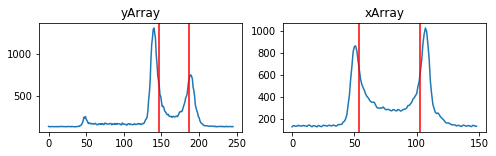

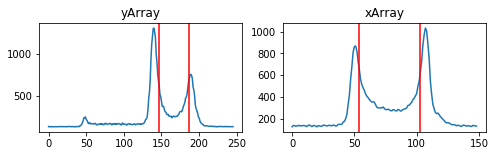

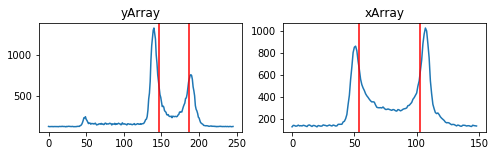

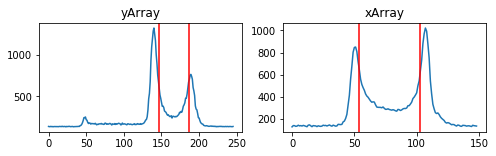

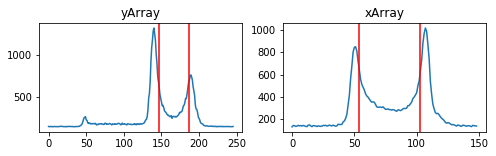

...

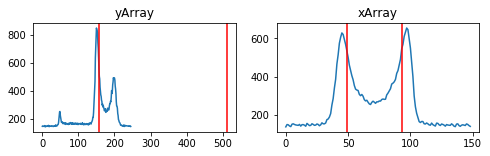

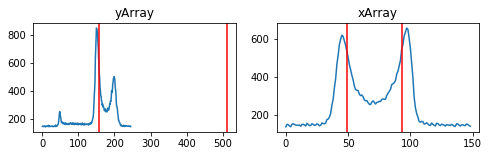

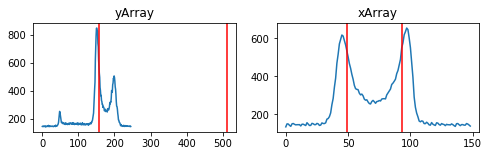

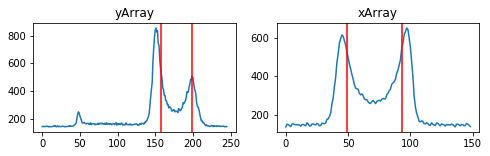

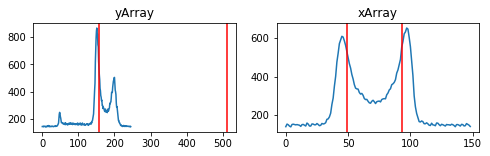

In [141]:
circlesPerFrame = []
frameDropped = []
verbose = True

centerx = center0px[0]
centery = center0px[1]
frameId = 0
for frameId in range(0,len(ch0)):
    
    
    image = ch0[frameId]
    
    
    if (frameId % 10==0):
        print(frameId)

    cimg = image
    img = image
    

    tresholdCalc = calculateThreshold(center0px,img)
    thresholds_xy= [tresholdCalc[0],tresholdCalc[0]]
    if(verbose):
        print("treshold: {}, insideGUV: {}, outside background: {}, ".format(tresholdCalc[0],tresholdCalc[1],tresholdCalc[2]))
    centerx, centery, radius = computeNewCircle([centerx,centery],img,thresholds_xy,verbose=verbose)
    #print("centerx {} centery {}".format(centerx,centery))
    
    
    circles = [[[centery,centerx,radius]]]
    circles = np.uint16(np.around(circles))
        
        
        
    circlesPerFrame.append(circles[0])
    
    if(verbose):
        for i in circles[0,:]:
            # draw the outer circle
            cv2.circle(cimg,(i[0],i[1]),i[2],(0,255,0),1)
            # draw the center of the circle
            cv2.circle(cimg,(i[0],i[1]),2,(0,0,255),1)        
        #plt.imshow(cimg)
        plt.savefig('./vesicle_circleFit/circleFit_frame_'+str(frameId)+'.png')

        frameDropped.append([frameId,False]) 
    frameId = frameId+1
        

outputfolder = '.'
circlesPerFrameOut = np.array(circlesPerFrame).reshape(len(circlesPerFrame),3)
df = pd.DataFrame(circlesPerFrameOut)
df.to_csv(outputfolder+"/vesicle_center_radius.csv",header=['x[px]',"y[px]",'r[px]'])




